<a href="https://colab.research.google.com/github/sePerezAlbor/LAB1_EDD2__202330/blob/main/Laboratorio_2_Estructura_de_datos_II.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **LABORATORIO 2**

Integrantes:


*   Kanery Marcela Camargo Rodríguez.
*   Emanuel de Jesús Carbonell Naranjo.
*   Sebastián Alfonso Pérez Albor.



In [ ]:
#Antes de empezar a usar el programa se debe subir el CSV que en este caso se llamará "vuelos"
#Librerias que se usan.
import pandas as pd
import math
import folium as fl
import networkx as nx
from folium import plugins
from geopy.distance import great_circle

In [ ]:
# Lee un archivo CSV en un DataFrame de pandas
df = pd.read_csv('vuelos.csv')
df

,Source Airport Code,Source Airport Name,Source Airport City,Source Airport Country,Source Airport Latitude,Source Airport Longitude,Destination Airport Code,Destination Airport Name,Destination Airport City,Destination Airport Country,Destination Airport Latitude,Destination Airport Longitude
0,COK,Cochin International Airport,Kochi,India,10.152000,76.401901,SHJ,Sharjah International Airport,Sharjah,United Arab Emirates,25.328600,55.517200
1,GIG,Rio Galeão – Tom Jobim International Airport,Rio De Janeiro,Brazil,-22.809999,-43.250557,BSB,Presidente Juscelino Kubistschek International...,Brasilia,Brazil,-15.869167,-47.920834
2,TSF,Treviso-Sant'Angelo Airport,Treviso,Italy,45.648399,12.194400,BRI,Bari Karol Wojtyła Airport,Bari,Italy,41.138901,16.760599
3,CDG,Charles de Gaulle International Airport,Paris,France,49.012798,2.550000,FLR,Peretola Airport,Florence,Italy,43.810001,11.205100
4,CGH,Congonhas Airport,Sao Paulo,Brazil,-23.626110,-46.656387,CGB,Marechal Rondon Airport,Cuiaba,Brazil,-15.652900,-56.116699
...,...,...,...,...,...,...,...,...,...,...,...,...
66925,CAN,Guangzhou Baiyun International Airport,Guangzhou,China,23.392401,113.299004,WUH,Wuhan Tianhe International Airport,Wuhan,China,30.783800,114.208000
66926,MSR,Muş Airport,Mus,Turkey,38.747799,41.661201,SAW,Sabiha Gökçen International Airport,Istanbul,Turkey,40.898602,29.309200
66927,DEN,Denver International Airport,Denver,United States,39.861698,-104.672996,OMA,Eppley Airfield,Omaha,United States,41.303200,-95.894096
66928,SHE,Taoxian Airport,Shenyang,China,41.639801,123.483002,CIF,Chifeng Airport,Chifeng,China,42.235001,118.907997


In [ ]:
# Filtra el DataFrame para obtener filas únicas basadas en 'CodigoAeropuertoSalida'
df_filtrado = df.drop_duplicates(subset=['Source Airport Code']) #Elimina los duplicados.
df_filtrado #Todos los aeropuertos que hay (sin repetirse).

,Source Airport Code,Source Airport Name,Source Airport City,Source Airport Country,Source Airport Latitude,Source Airport Longitude,Destination Airport Code,Destination Airport Name,Destination Airport City,Destination Airport Country,Destination Airport Latitude,Destination Airport Longitude
0,COK,Cochin International Airport,Kochi,India,10.152000,76.401901,SHJ,Sharjah International Airport,Sharjah,United Arab Emirates,25.328600,55.517200
1,GIG,Rio Galeão – Tom Jobim International Airport,Rio De Janeiro,Brazil,-22.809999,-43.250557,BSB,Presidente Juscelino Kubistschek International...,Brasilia,Brazil,-15.869167,-47.920834
2,TSF,Treviso-Sant'Angelo Airport,Treviso,Italy,45.648399,12.194400,BRI,Bari Karol Wojtyła Airport,Bari,Italy,41.138901,16.760599
3,CDG,Charles de Gaulle International Airport,Paris,France,49.012798,2.550000,FLR,Peretola Airport,Florence,Italy,43.810001,11.205100
4,CGH,Congonhas Airport,Sao Paulo,Brazil,-23.626110,-46.656387,CGB,Marechal Rondon Airport,Cuiaba,Brazil,-15.652900,-56.116699
...,...,...,...,...,...,...,...,...,...,...,...,...
66737,KME,Kamembe Airport,Kamembe,Rwanda,-2.462240,28.907900,KGL,Kigali International Airport,Kigali,Rwanda,-1.968630,30.139500
66739,EAT,Pangborn Memorial Airport,Wenatchee,United States,47.398899,-120.207001,SEA,Seattle Tacoma International Airport,Seattle,United States,47.449001,-122.308998
66773,PYY,Mae Hong Son Airport,Pai,Thailand,19.372000,98.436996,CNX,Chiang Mai International Airport,Chiang Mai,Thailand,18.766800,98.962601
66854,LAR,Laramie Regional Airport,Laramie,United States,41.312099,-105.675003,DEN,Denver International Airport,Denver,United States,39.861698,-104.672996


In [ ]:
# Obtener las columnas de latitud , longitud y codigos de los aeropuertos en forma de listas
latitudes = df_filtrado['Source Airport Latitude'].tolist()
longitudes = df_filtrado['Source Airport Longitude'].tolist()
codigos = df_filtrado['Source Airport Code'].tolist()
nombres = df_filtrado['Source Airport Name'].tolist()
Ciudad = df_filtrado['Source Airport City'].tolist()
pais = df_filtrado['Source Airport Country'].tolist()
len(latitudes) #Para verificar que esten todas las latitudes de todos los aeropuertos.


3240

In [ ]:
# Crear un mapa centrado en una ubicación
m = fl.Map(location=[0, 0], zoom_start=2)

# Agregar marcadores para cada aeropuerto en el mapa
# Los ubica dependiendo la latitud , la longitud y el codigo.
for lat, lon, codigo, nombres, Ciudad, pais,  in zip(latitudes, longitudes, codigos, nombres, Ciudad, pais):
    fl.Marker([lat, lon], tooltip=("Codigo Aereopuerto: ",codigo,"Latitud: ", lat,"Longitud: ", lon ,"Nombre del aereopuerto: ",nombres,pais,Ciudad), icon=fl.Icon(icon="map-marker", icon_size=(5, 5))).add_to(m)
    #Tooltip es la marca que sale en cada icono (el code del aeropuerto)

In [ ]:
# Muestra el mapa solo localizando los aeropuertos.
m

In [ ]:
grafo = nx.Graph()  # Crea un grafo no dirigido

In [ ]:
# Agrega aristas (conexiones entre aeropuertos) al grafo
for indice, fila in df.iterrows():
    origen = fila["Source Airport Code"]
    destino = fila["Destination Airport Code"]
    grafo.add_edge(origen, destino)

In [ ]:
# Agrega líneas entre aeropuertos para representar las conexiones
for origen, destino in grafo.edges:
    # Verifica si el valor "origen" existe en la columna "Source Airport Code"
    if origen in df["Source Airport Code"].values:
        origen_info = df[df["Source Airport Code"] == origen].iloc[0]
        origen_coords = (origen_info["Source Airport Latitude"], origen_info["Source Airport Longitude"])

        # Verifica si el valor "destino" existe en la columna "Source Airport Code"
        if destino in df["Source Airport Code"].values:
            destino_info = df[df["Source Airport Code"] == destino].iloc[0]
            destino_coords = (destino_info["Source Airport Latitude"], destino_info["Source Airport Longitude"])
            fl.PolyLine([origen_coords, destino_coords], color="blue").add_to(m)

        else:
            # Manejar el caso en el que el "destino" no se encuentra en el DataFrame
            print(f"Aeropuerto {destino} no encontrado en el DataFrame")
    else:
        # Manejar el caso en el que el "origen" no se encuentra en el DataFrame
        print(f"Aeropuerto {origen} no encontrado en el DataFrame")

Aeropuerto SPI no encontrado en el DataFrame
Aeropuerto SPI no encontrado en el DataFrame
Aeropuerto KZI no encontrado en el DataFrame
Aeropuerto TUA no encontrado en el DataFrame
Aeropuerto SPI no encontrado en el DataFrame
Aeropuerto AGN no encontrado en el DataFrame
Aeropuerto KUK no encontrado en el DataFrame
Aeropuerto CHU no encontrado en el DataFrame
Aeropuerto ORX no encontrado en el DataFrame
Aeropuerto SPI no encontrado en el DataFrame
Aeropuerto BVS no encontrado en el DataFrame
Aeropuerto PIP no encontrado en el DataFrame
Aeropuerto MLY no encontrado en el DataFrame
Aeropuerto QFG no encontrado en el DataFrame
Aeropuerto UII no encontrado en el DataFrame
Aeropuerto DLZ no encontrado en el DataFrame
Aeropuerto ORX no encontrado en el DataFrame
Aeropuerto ORX no encontrado en el DataFrame
Aeropuerto FMI no encontrado en el DataFrame
Aeropuerto CMP no encontrado en el DataFrame
Aeropuerto KYK no encontrado en el DataFrame


In [ ]:
m #Muestra el mapa con las aristas (las conexiones entre los aeropuertos.)

In [ ]:
#Peso de las aristas (Distancia entre dos coordenadas geográficas)
df_cll = df.copy()

# Función para calcular la distancia usando Haversine
def haversine(LA1, LO1, LA2, LO2):
    R = 6371.0 # Radio de la Tierra en kilómetros (tomandolo como una esfera perfecta)
    # Convierte la latitud y la longitud a radianes (porque asi esta dada la formula)
    LA1R = math.radians(LA1)
    LO1R = math.radians(LO1)
    LA2R = math.radians(LA2)
    LO2R = math.radians(LO2)
    # Distancias entre latitudes y longitudes
    DLAT = LA2R - LA1R
    DLON = LO2R - LO1R
    # Fórmula de Haversine
    RAIZ = math.sin(DLAT / 2)**2 + math.cos(LA1R) * math.cos(LA2R) * math.sin(DLON / 2)**2
    TRAIZ = 2 * math.atan2(math.sqrt(RAIZ), math.sqrt(1 - RAIZ))
    # Calcula la distancia
    D = R * TRAIZ
    return D

def distancia(fila):
    LA1, LO1 = fila['Source Airport Latitude'], fila['Source Airport Longitude']
    LA2, LO2 = fila['Destination Airport Latitude'], fila['Destination Airport Longitude']
    DG = haversine(LA1, LO1,LA2, LO2) #aqui calcula la distancia geográfica entre los dos aeropuertos.
    return DG


df_cll['Distancia geográfica'] = df.apply(distancia, axis=1) #agrega una nueva columna a la base de datos (filtrada)
df_cll

,Source Airport Code,Source Airport Name,Source Airport City,Source Airport Country,Source Airport Latitude,Source Airport Longitude,Destination Airport Code,Destination Airport Name,Destination Airport City,Destination Airport Country,Destination Airport Latitude,Destination Airport Longitude,Distancia geográfica
0,COK,Cochin International Airport,Kochi,India,10.152000,76.401901,SHJ,Sharjah International Airport,Sharjah,United Arab Emirates,25.328600,55.517200,2774.426364
1,GIG,Rio Galeão – Tom Jobim International Airport,Rio De Janeiro,Brazil,-22.809999,-43.250557,BSB,Presidente Juscelino Kubistschek International...,Brasilia,Brazil,-15.869167,-47.920834,913.971019
2,TSF,Treviso-Sant'Angelo Airport,Treviso,Italy,45.648399,12.194400,BRI,Bari Karol Wojtyła Airport,Bari,Italy,41.138901,16.760599,622.306540
3,CDG,Charles de Gaulle International Airport,Paris,France,49.012798,2.550000,FLR,Peretola Airport,Florence,Italy,43.810001,11.205100,879.346159
4,CGH,Congonhas Airport,Sao Paulo,Brazil,-23.626110,-46.656387,CGB,Marechal Rondon Airport,Cuiaba,Brazil,-15.652900,-56.116699,1328.590433
...,...,...,...,...,...,...,...,...,...,...,...,...,...
66925,CAN,Guangzhou Baiyun International Airport,Guangzhou,China,23.392401,113.299004,WUH,Wuhan Tianhe International Airport,Wuhan,China,30.783800,114.208000,826.785703
66926,MSR,Muş Airport,Mus,Turkey,38.747799,41.661201,SAW,Sabiha Gökçen International Airport,Istanbul,Turkey,40.898602,29.309200,1080.631351
66927,DEN,Denver International Airport,Denver,United States,39.861698,-104.672996,OMA,Eppley Airfield,Omaha,United States,41.303200,-95.894096,758.139815
66928,SHE,Taoxian Airport,Shenyang,China,41.639801,123.483002,CIF,Chifeng Airport,Chifeng,China,42.235001,118.907997,384.116204


In [ ]:
df=df_cll
# Crear un grafo
G = nx.Graph()

# Agregar nodos y aristas al grafo con la base con las distancias
for _, row in df.iterrows():
    origen = row['Source Airport Code']
    destino = row['Destination Airport Code']
    distancia = row['Distancia geográfica']
    G.add_edge(origen, destino, weight=distancia)

# Función para calcular el camino mínimo de la libreria nx
def calcular_camino_minimo(origen, destino):
    try:
        camino_minimo = nx.shortest_path(G, source=origen, target=destino, weight='weight')
        return camino_minimo
    except nx.NetworkXNoPath:
        return None

# Ingresa los códigos de origen y destino
origen = input("Digite el codigo de El aereopuerto de origen: ")
destino = input("Digite el codigo de El aereopuerto de destino: ")

# Calcular el camino mínimo
camino_minimo = calcular_camino_minimo(origen, destino)

# Crear un mapa
mapa = fl.Map(location=[0, 0], zoom_start=5)

# Dibujo camino y print del recorrido
if camino_minimo:
    coordenadas_camino = []
    for i in range(len(camino_minimo) - 1):
        aeropuerto1 = camino_minimo[i]
        aeropuerto2 = camino_minimo[i + 1]
        lat1 = df.loc[df['Source Airport Code'] == aeropuerto1]['Source Airport Latitude'].values[0]
        lon1 = df.loc[df['Source Airport Code'] == aeropuerto1]['Source Airport Longitude'].values[0]
        cit1 = df.loc[df['Source Airport Code'] == aeropuerto1]['Source Airport City'].values[0]
        pai1 = df.loc[df['Source Airport Code'] == aeropuerto1]['Source Airport Country'].values[0]
        nom1 = df.loc[df['Source Airport Code'] == aeropuerto1]['Source Airport Name'].values[0]

        lat2 = df.loc[df['Source Airport Code'] == aeropuerto2]['Source Airport Latitude'].values[0]
        lon2 = df.loc[df['Source Airport Code'] == aeropuerto2]['Source Airport Longitude'].values[0]
        cit2 = df.loc[df['Source Airport Code'] == aeropuerto2]['Source Airport City'].values[0]
        pai2 = df.loc[df['Source Airport Code'] == aeropuerto2]['Source Airport Country'].values[0]
        nom2 = df.loc[df['Source Airport Code'] == aeropuerto2]['Source Airport Name'].values[0]
        coordenadas_camino.extend([(lat1, lon1), (lat2, lon2)])
        fl.Marker([lat1, lon1],icon=fl.CustomIcon(icon_image="avrojo.jpg", icon_size=(30, 30)), tooltip=aeropuerto1).add_to(mapa)
        fl.Marker([lat2, lon2],icon=fl.CustomIcon(icon_image="avrojo.jpg", icon_size=(30, 30)), tooltip=aeropuerto2).add_to(mapa)
        if(i==0):
          fl.Marker([lat1, lon1],icon=fl.CustomIcon(icon_image="avazul.jpg", icon_size=(30, 30)), tooltip=aeropuerto1).add_to(mapa)
          fl.Marker([lat2, lon2],icon=fl.CustomIcon(icon_image="avrojo.jpg", icon_size=(30, 30)), tooltip=aeropuerto2).add_to(mapa)
        if(i==len(camino_minimo) - 2):
          fl.Marker([lat1, lon1],icon=fl.CustomIcon(icon_image="avrojo.jpg", icon_size=(30, 30)), tooltip=aeropuerto1).add_to(mapa)
          fl.Marker([lat2, lon2],icon=fl.CustomIcon(icon_image="avverde.jpg", icon_size=(30, 30)), tooltip=aeropuerto2).add_to(mapa)
        print("El vuelo #",i+1,"Parte de :",nom1,"(",aeropuerto1,")","de ",cit1,", ",pai1,"en las coordenadas (",lat1,",",lon1,")")
        print("Aterriza en :",nom2,"(",aeropuerto2,")","de ",cit2,", ",pai2,"en las coordenadas (",lat2,",",lon2,")")
    fl.PolyLine(coordenadas_camino, color='green').add_to(mapa)
else:
    print(f"No hay un camino válido entre {origen} y {destino}.")


Digite el codigo de El aereopuerto de origen: MDQ
Digite el codigo de El aereopuerto de destino: LEA
El vuelo # 1 Parte de : Ástor Piazzola International Airport ( MDQ ) de  Mar Del Plata ,  Argentina en las coordenadas ( -37.9342 , -57.5733 )
Aterriza en : Jorge Newbery Airpark ( AEP ) de  Buenos Aires ,  Argentina en las coordenadas ( -34.5592 , -58.4156 )
El vuelo # 2 Parte de : Jorge Newbery Airpark ( AEP ) de  Buenos Aires ,  Argentina en las coordenadas ( -34.5592 , -58.4156 )
Aterriza en : Comodoro Arturo Merino Benítez International Airport ( SCL ) de  Santiago ,  Chile en las coordenadas ( -33.39300156 , -70.78579712 )
El vuelo # 3 Parte de : Comodoro Arturo Merino Benítez International Airport ( SCL ) de  Santiago ,  Chile en las coordenadas ( -33.39300156 , -70.78579712 )
Aterriza en : Sydney Kingsford Smith International Airport ( SYD ) de  Sydney ,  Australia en las coordenadas ( -33.94609833 , 151.177002 )
El vuelo # 4 Parte de : Sydney Kingsford Smith International Airpo


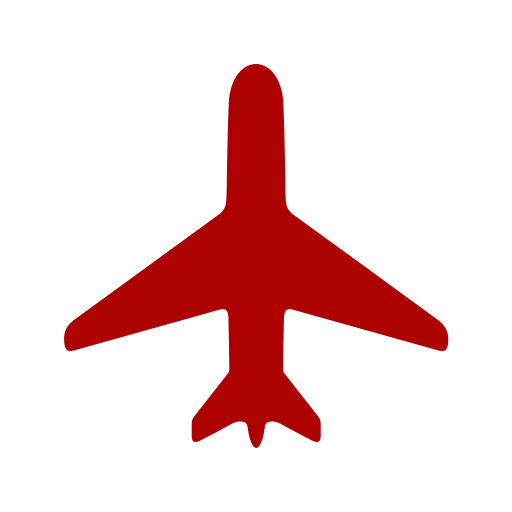
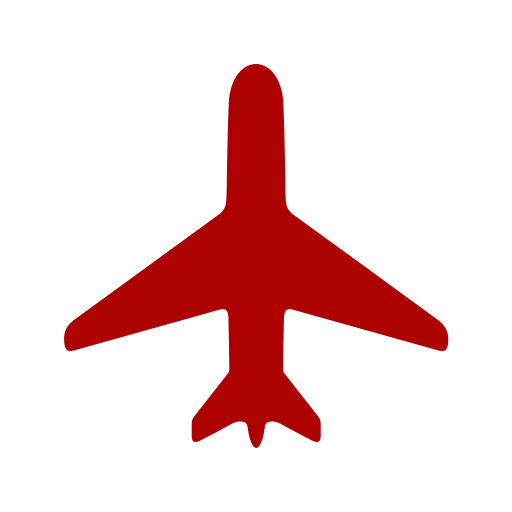
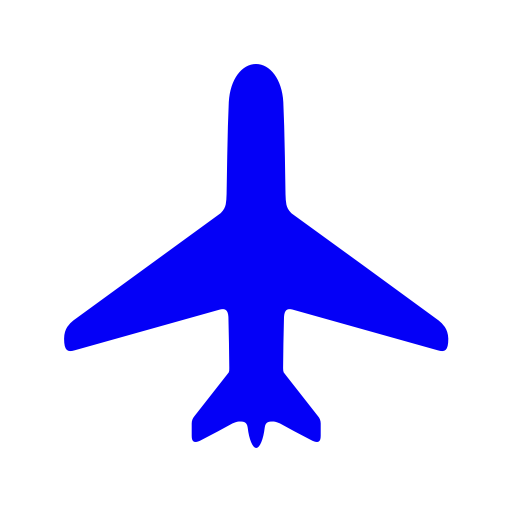
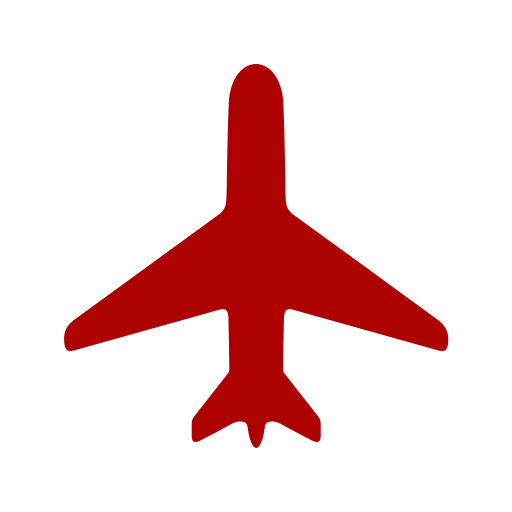
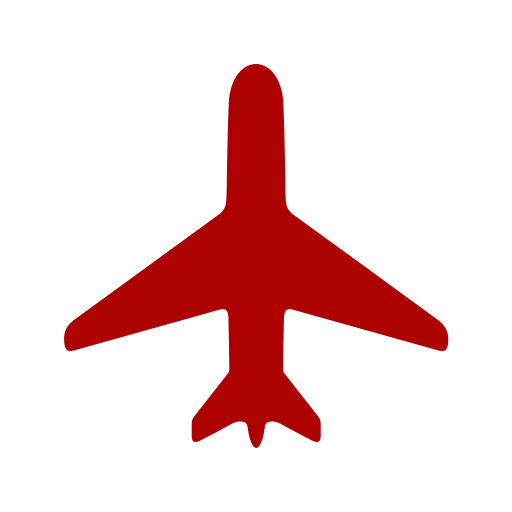
...
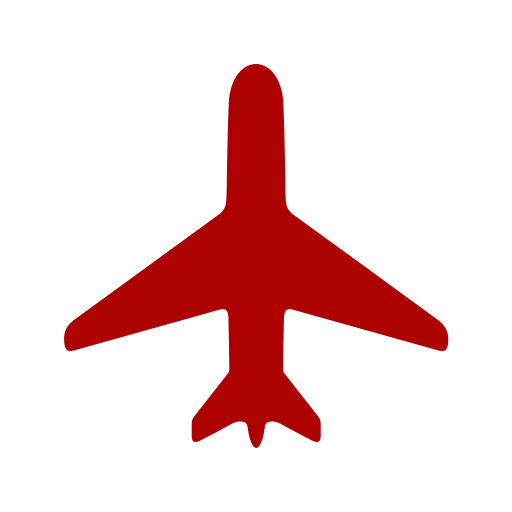
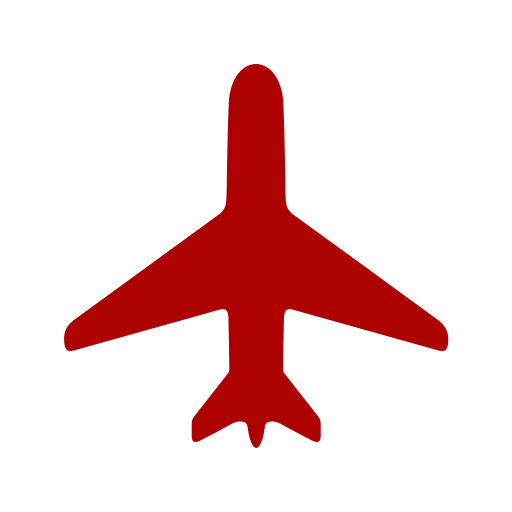
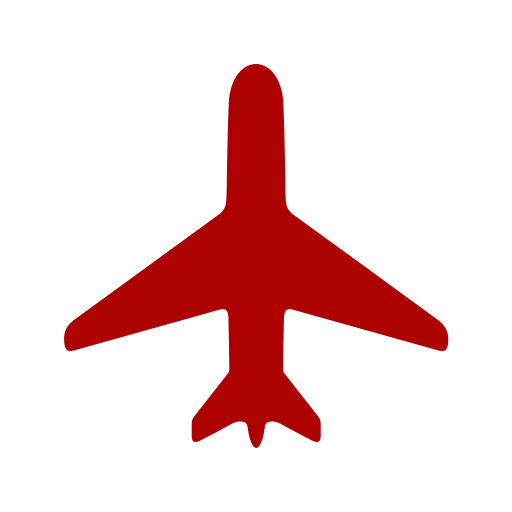
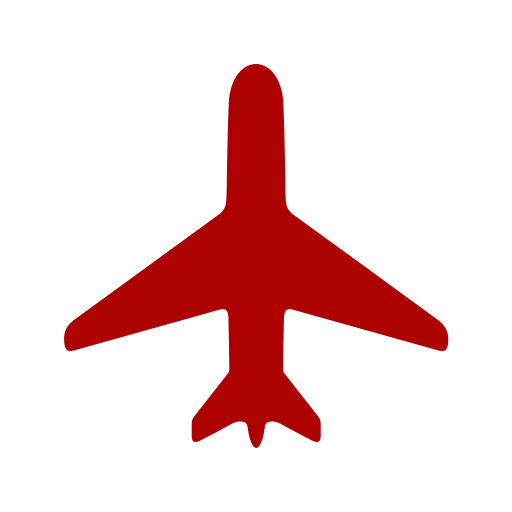
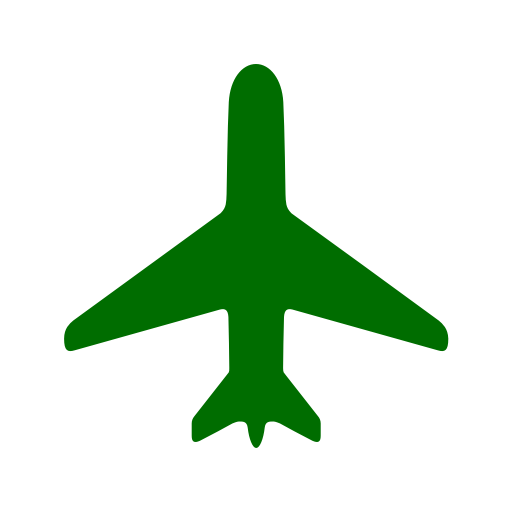

In [ ]:
mapa

In [ ]:
# Crear un grafo ponderado utilizando NetworkX
from folium import plugins

G = nx.Graph()
mapa_mins = fl.Map(location=[0, 0], zoom_start=2)
# Agregar nodos y aristas al grafo
for _, row in df_cll.iterrows():
    origen = row['Source Airport Code']
    destino = row['Destination Airport Code']
    distancia = row['Distancia geográfica']
    G.add_edge(origen, destino, weight=distancia)

# Elegir un aeropuerto de origen
origen = input("Digite el codigo del aereopuerto: ")
fl.Marker([df_cll.loc[df_cll['Source Airport Code'] == origen]['Source Airport Latitude'].values[0],df_cll.loc[df_cll['Source Airport Code'] == origen]['Source Airport Longitude'].values[0] ],icon=fl.CustomIcon(icon_image="avazul.jpg", icon_size=(30, 30)),tooltip=(df_cll.loc[df_cll['Source Airport Code'] == origen]['Source Airport Code'].values[0],df_cll.loc[df_cll['Source Airport Code'] == origen]['Source Airport City'].values[0],df_cll.loc[df_cll['Source Airport Code'] == origen]['Source Airport Country'].values[0],df_cll.loc[df_cll['Source Airport Code'] == origen]['Source Airport Code'].values[0],df_cll.loc[df_cll['Source Airport Code'] == origen]['Source Airport Name'].values[0]) ).add_to(mapa_mins)
# +Encontrar los 10 caminos mínimos más largos desde el aeropuerto de origen
caminos_minimos_mas_largos = []
for destino in G.nodes():
    if destino != origen:
        try:
            camino_minimo = nx.shortest_path(G, source=origen, target=destino, weight='weight')
            distancia_camino = sum(G[camino_minimo[i]][camino_minimo[i+1]]['weight'] for i in range(len(camino_minimo) - 1))
            caminos_minimos_mas_largos.append((camino_minimo, distancia_camino))
        except nx.NetworkXNoPath:
            continue

# Ordenar los caminos por distancia en orden descendente
caminos_minimos_mas_largos.sort(key=lambda x: x[1], reverse=True)

# Obtener los 10 caminos más largos
top_10_caminos_mas_largos = caminos_minimos_mas_largos[:10]

# Imprimir o trabajar con los resultados
for camino, distancia in top_10_caminos_mas_largos:
    print("Camino:", camino)
    print("Distancia:", distancia)

for camino, _ in top_10_caminos_mas_largos:
    coordenadas_camino = []
    for i in range(len(camino) - 1):
        aeropuerto1 = camino[i]
        aeropuerto2 = camino[i + 1]
        lat1 = df_cll.loc[df_cll['Source Airport Code'] == aeropuerto1]['Source Airport Latitude'].values[0]
        lon1 = df_cll.loc[df_cll['Source Airport Code'] == aeropuerto1]['Source Airport Longitude'].values[0]
        lat2 = df_cll.loc[df_cll['Source Airport Code'] == aeropuerto2]['Source Airport Latitude'].values[0]
        lon2 = df_cll.loc[df_cll['Source Airport Code'] == aeropuerto2]['Source Airport Longitude'].values[0]
        coordenadas_camino.extend([(lat1, lon1), (lat2, lon2)])
        if(i==len(camino) - 2):
          fl.Marker([lat2, lon2],icon=fl.CustomIcon(icon_image="avverde.jpg", icon_size=(30, 30)), tooltip=(df_cll.loc[df_cll['Source Airport Code'] == aeropuerto2]['Source Airport City'].values[0],df_cll.loc[df_cll['Source Airport Code'] == aeropuerto2]['Source Airport Country'].values[0],df_cll.loc[df_cll['Source Airport Code'] == aeropuerto2]['Source Airport Code'].values[0],df_cll.loc[df_cll['Source Airport Code'] == aeropuerto2]['Source Airport Name'].values[0],lat1,lon1)).add_to(mapa_mins)
    fl.PolyLine(coordenadas_camino, color='green').add_to(mapa_mins)

Digite el codigo del aereopuerto: MDQ
Camino: ['MDQ', 'AEP', 'GRU', 'IST', 'URC', 'HET', 'NAY', 'FUO']
Distancia: 21658.327561312075
Camino: ['MDQ', 'AEP', 'SCL', 'AKL', 'PVG', 'YNY']
Distancia: 21544.070257632146
Camino: ['MDQ', 'AEP', 'GRU', 'IST', 'URC', 'SHA', 'LCX']
Distancia: 21382.185897480278
Camino: ['MDQ', 'AEP', 'SCL', 'SYD', 'DPS', 'TIM', 'DJJ', 'MKQ']
Distancia: 21054.66849689093
Camino: ['MDQ', 'AEP', 'GRU', 'MXP', 'PEK', 'GYS']
Distancia: 20949.819982444496
Camino: ['MDQ', 'AEP', 'SCL', 'SYD', 'MNL', 'XMN', 'JUZ']
Distancia: 20787.00805773364
Camino: ['MDQ', 'AEP', 'GIG', 'LAD', 'NBO', 'BOM', 'HKG', 'TNN']
Distancia: 20759.966357666362
Camino: ['MDQ', 'AEP', 'GIG', 'LFW', 'ABV', 'NDJ', 'JED', 'DOH', 'CKG', 'HYN']
Distancia: 20759.567007945592
Camino: ['MDQ', 'AEP', 'GRU', 'MXP', 'PEK', 'TAO', 'JNZ']
Distancia: 20733.01254629019
Camino: ['MDQ', 'AEP', 'SCL', 'IPC', 'PPT', 'NRT', 'CJU', 'WJU']
Distancia: 20726.97915326153



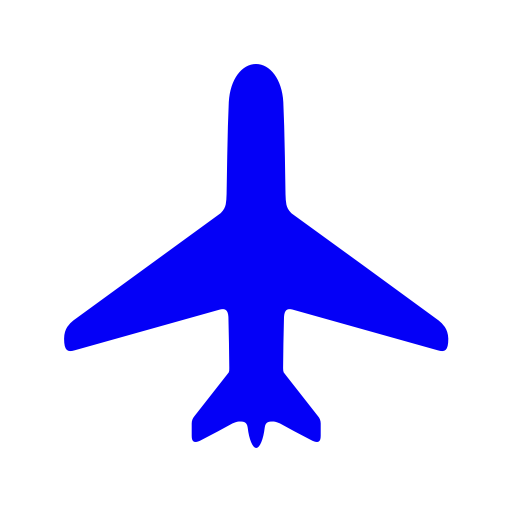
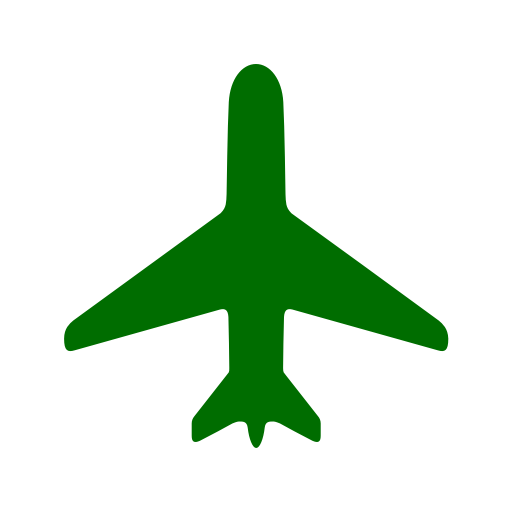
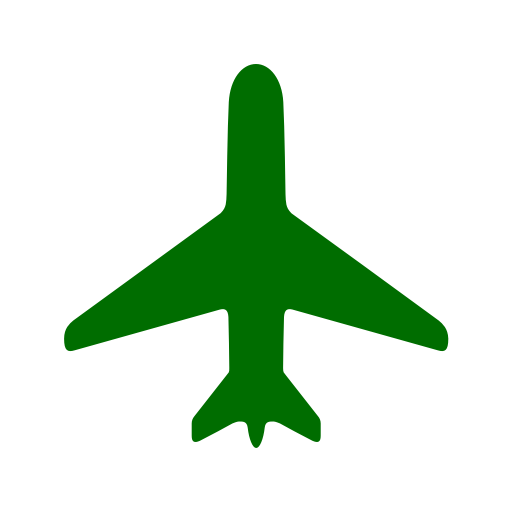
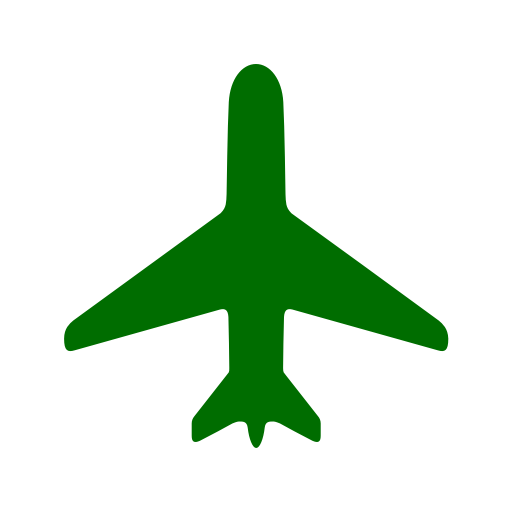
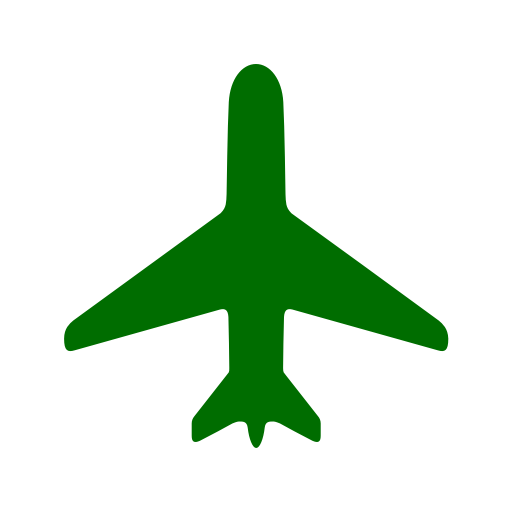
...
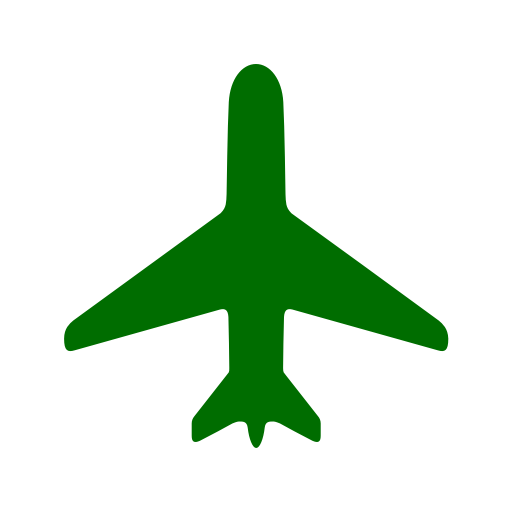
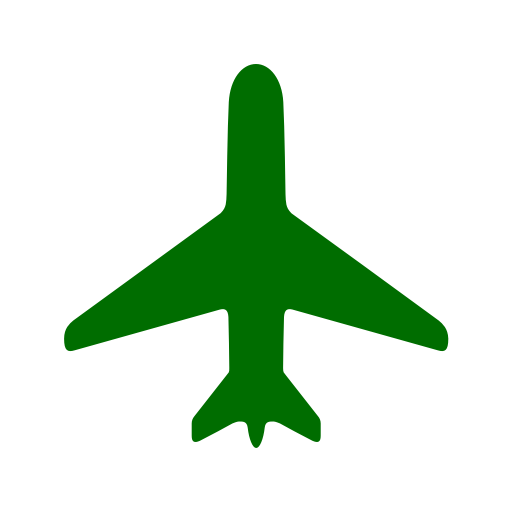
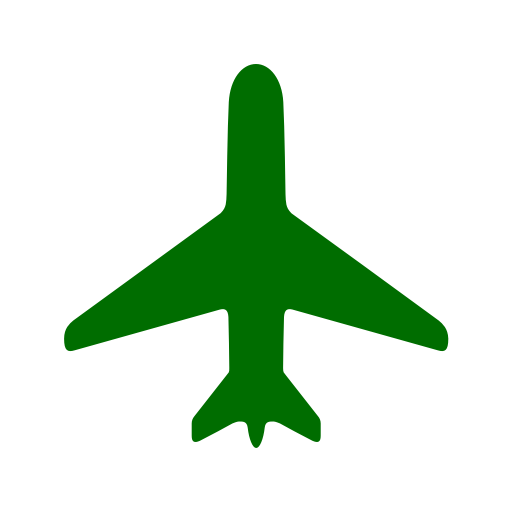
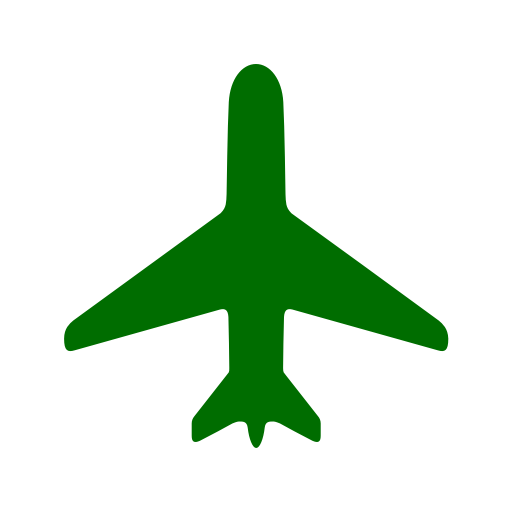
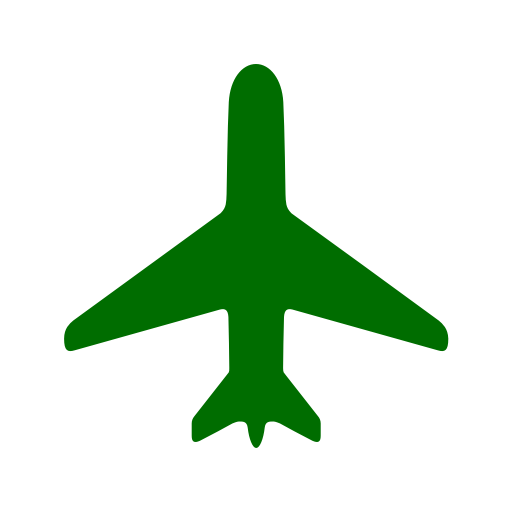

In [ ]:
mapa_mins